**Lab 12 – XAI**

_This notebook contains the sample from https://www.kaggle.com/learn/machine-learning-explainability, https://scikit-learn.org/stable/modules/partial_dependence.html#, https://github.com/csinva/imodels, https://github.com/marcotcr/lime, https://github.com/slundberg/shap, https://github.com/keisen/tf-keras-vis and https://github.com/fchollet/deep-learning-with-python-notebooks/blob/master/chapter09_part03_interpreting-what-convnets-learn.ipynb

<table align="left">
  <td>
    <a href="https://colab.research.google.com/github/phonchi/nsysu-math604/blob/master/static_files/presentations/12_XAI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>
  </td>
  <td>
    <a target="_blank" href="https://kaggle.com/kernels/welcome?src=https://github.com/phonchi/nsysu-math604/blob/master/static_files/presentations/12_XAI.ipynb"><img src="https://kaggle.com/static/images/open-in-kaggle.svg" /></a>
  </td>
</table>

In [61]:
!pip install --upgrade mlxtend -qq
!pip install imodels -qq
!pip install lime -qq
!pip install shap -qq
!pip install tf-keras-vis -qq

In [62]:
import numpy as np
import pandas as pd
import seaborn as sns
from scipy.io.arff import loadarff
import graphviz

from imodels import BayesianRuleListClassifier, RuleFitRegressor, FIGSRegressor, GreedyTreeRegressor
from imodels import OneRClassifier, BoostedRulesClassifier
from imodels.util.convert import tree_to_code
from imodels.discretization import ExtraBasicDiscretizer

from sklearn import tree
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.tree import DecisionTreeRegressor, plot_tree, DecisionTreeClassifier
from sklearn.neural_network import MLPRegressor

import tensorflow as tf
tf.compat.v1.disable_v2_behavior() #see https://github.com/slundberg/shap/issues/2189
from tensorflow import keras

from sklearn import metrics
from sklearn.metrics import mean_absolute_error
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import QuantileTransformer
from sklearn.datasets import fetch_california_housing
from sklearn.datasets import load_boston, load_iris

from sklearn.inspection import PartialDependenceDisplay
from sklearn.inspection import partial_dependence

import lime
import lime.lime_tabular
from lime import lime_image

import shap  # package used to calculate Shap values

from tf_keras_vis.utils.model_modifiers import ExtractIntermediateLayer, ReplaceToLinear
from tf_keras_vis.utils.scores import CategoricalScore
from tf_keras_vis.activation_maximization import ActivationMaximization
from tf_keras_vis.activation_maximization.callbacks import Progress
from tf_keras_vis.saliency import Saliency
from tf_keras_vis.gradcam import Gradcam
from tf_keras_vis.gradcam_plus_plus import GradcamPlusPlus
from tf_keras_vis.scorecam import Scorecam

from skimage.io import imread
from skimage.segmentation import mark_boundaries

import matplotlib as mpl
from matplotlib import pyplot as plt
from matplotlib import cm
%matplotlib inline

Instructions for updating:
non-resource variables are not supported in the long term


## Decsion-Rule based modeld by `imodels`

`imodels` provides a simple interface for fitting and using state-of-the-art interpretable models, all compatible with `scikit-learn`. These models can often replace black-box models (e.g. random forests) with simpler models (e.g. rule lists) while improving interpretability and computational efficiency, all without sacrificing predictive accuracy

In [ ]:
np.random.seed(42)

def get_reg_boston_data():
    '''load (regression) data on boston housing prices
    '''
    data = pd.read_csv('Boston.csv')
    feature_names = data.columns[1:-1]
    X_reg = data.iloc[:,1:-1]
    y_reg = data['medv']
    X_train_reg, X_test_reg, y_train_reg, y_test_reg = train_test_split(X_reg, y_reg, test_size=0.8)
    return X_train_reg, X_test_reg, y_train_reg, y_test_reg, feature_names

def get_diabetes_data():
    '''load (classification) data on diabetes
    '''
    data = loadarff("diabetes.arff")
    data_np = np.array(list(map(lambda x: np.array(list(x)), data[0])))
    X = data_np[:, :-1].astype('float32')
    y_text = data_np[:, -1].astype('str')
    y = (y_text == 'tested_positive').astype(int)  # labels 0-1
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.8) # split
    feature_names = ["#Pregnant", "Glucose concentration test", "Blood pressure(mmHg)",
                         "Triceps skin fold thickness(mm)",
                         "2-Hour serum insulin (mu U/ml)", "Body mass index", "Diabetes pedigree function",
                         "Age (years)"]
    return X_train, X_test, y_train, y_test, feature_names

def viz_classification_preds(probs, y_test):
    '''look at prediction breakdown
    '''
    plt.subplot(121)
    plt.hist(probs[:, 1][y_test==0], label='Class 0')
    plt.hist(probs[:, 1][y_test==1], label='Class 1', alpha=0.8)
    plt.ylabel('Count')
    plt.xlabel('Predicted probability of class 1')
    plt.legend()
    
    plt.subplot(122)
    preds = np.argmax(probs, axis=1)
    plt.title('ROC curve')
    fpr, tpr, thresholds = metrics.roc_curve(y_test, preds)
    plt.xlabel('False positive rate')
    plt.ylabel('True positive rate')
    plt.plot(fpr, tpr)
    plt.tight_layout()
    plt.show()

The diabetes dataset has a binary-valued variable. We would like to investigated whether the patient shows signs of diabetes according to World Health Organization riteria. The boston dataset is a housing dataset that use seveal conditions to predict the housing price.

In [ ]:
X_train_reg, X_test_reg, y_train_reg, y_test_reg, feat_names_reg = get_reg_boston_data()
X_train, X_test, y_train, y_test, feat_names = get_diabetes_data()

# load some data
print('regression data', X_train_reg.shape, 'classification data', X_train.shape)

regression data (101, 12) classification data (153, 8)


### Rule lists

Rule list is nonoverlapping

#### oneR
Fits a rule list restricted to use only one feature

Classifier Accuracy: 0.7398373983739838 
 Learned interpretable model:
 mean 0.373 (153 pts)
if Glucose concentration test >= 138.0 then 0.721 (43 pts)
mean 0.236 (110 pts)
if Glucose concentration test >= 108.0 then 0.344 (61 pts)
mean 0.102 (49 pts)
if Glucose concentration test >= 84.0 then 0.132 (38 pts)
mean 0 (11 pts)



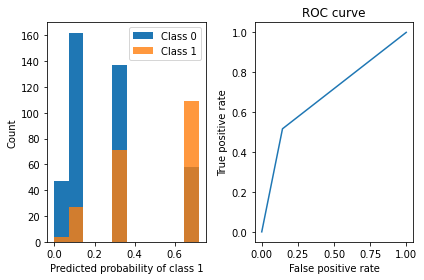

In [ ]:
# fit a oneR model
model = OneRClassifier()
model.fit(X_train, y=y_train, feature_names=feat_names) # stores into m.rules_
probs = model.predict_proba(X_test)
preds = model.predict(X_test)

# print the rule list
print("Classifier Accuracy:", np.mean(y_test == preds), "\n Learned interpretable model:\n", model)

# look at prediction breakdown
viz_classification_preds(probs, y_test)

#### Bayesian rule lists

In [ ]:
# train classifier (allow more iterations for better accuracy; use BigDataRuleListClassifier for large datasets)

# All numeric features must be discretized prior to fitting!
disc = ExtraBasicDiscretizer(feat_names, n_bins=3, strategy='uniform')
X_train_disc = disc.fit_transform(pd.DataFrame(X_train, columns=feat_names))
X_test_disc = disc.transform(pd.DataFrame(X_test, columns=feat_names))

X_train_disc

,#Pregnant_0.0_to_5.666666666666667,#Pregnant_5.666666666666667_to_11.333333333333334,#Pregnant_11.333333333333334_to_17.0,Glucose concentration test_0.0_to_65.66666666666667,Glucose concentration test_65.66666666666667_to_131.33333333333334,Glucose concentration test_131.33333333333334_to_197.0,Blood pressure(mmHg)_0.0_to_35.333333333333336,Blood pressure(mmHg)_35.333333333333336_to_70.66666666666667,Blood pressure(mmHg)_70.66666666666667_to_106.0,Triceps skin fold thickness(mm)_0.0_to_20.0,...,2-Hour serum insulin (mu U/ml)_362.0_to_543.0,Body mass index_0.0_to_19.099999745686848,Body mass index_19.099999745686848_to_38.199999491373696,Body mass index_38.199999491373696_to_57.29999923706055,Diabetes pedigree function_0.08900000154972076_to_0.5926666756470998,Diabetes pedigree function_0.5926666756470998_to_1.096333349744479,Diabetes pedigree function_1.096333349744479_to_1.600000023841858,Age (years)_21.0_to_37.0,Age (years)_37.0_to_53.0,Age (years)_53.0_to_69.0
0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
1,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
2,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
3,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
4,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,...,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
148,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0
149,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,...,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
150,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,...,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
151,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0


RuleListClassifier Accuracy: 0.7382113821138211 
 Learned interpretable model:
 Trained RuleListClassifier for detecting diabetes
IF Glucose concentration test_131.33333333333334_to_197.0 > 0.5 THEN probability of diabetes: 65.4% (52.1%-77.6%)
ELSE IF Triceps skin fold thickness(mm)_40.0_to_60.0 > 0.5 THEN probability of diabetes: 42.9% (19.2%-68.4%)
ELSE IF #Pregnant_0.0_to_5.666666666666667 > 0.5 THEN probability of diabetes: 14.7% (7.4%-24.0%)
ELSE probability of diabetes: 40.7% (23.4%-59.4%)



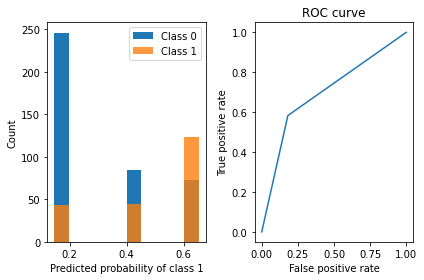

In [ ]:
model = BayesianRuleListClassifier(max_iter=3000, class1label="diabetes", verbose=False)
model.fit(X_train_disc, y_train, feature_names=X_train_disc.columns)
probs = model.predict_proba(X_test_disc)
preds = model.predict(X_test_disc.values, threshold=0.5)
print("RuleListClassifier Accuracy:", np.mean(y_test == preds), "\n Learned interpretable model:\n", model)
viz_classification_preds(probs, y_test)

### Rule sets


Rule sets are models that create a set of (potentially overlapping) rules.

#### Rulefit 

It fits a sparse linear model on rules extracted from decision trees

In [ ]:
# fit a rulefit model
model = RuleFitRegressor(max_rules=20)
model.fit(X_train_reg, y_train_reg, feature_names=feat_names_reg)

# get test performance
preds = model.predict(X_test_reg)
print(f'test mse: {metrics.mean_squared_error(y_test_reg, preds):0.2f}')
print(f'test r2: {metrics.r2_score(y_test_reg, preds):0.2f}')


# inspect and print the rules
#rules = model._get_rules()
#rules = rules[rules.coef != 0].sort_values("support", ascending=False)
# 'rule' is how the feature is constructed
# 'coef' is its weight in the final linear model
# 'support' is the fraction of points it applies to
#rules[['rule', 'coef', 'support']].style.background_gradient(cmap='viridis')
print(model)

test mse: 21.96
test r2: 0.75
RuleFit:
                                                            rule  coef
                                                           lstat -0.20
                                                   lstat > 5.155 -2.40
                                  rm <= 7.1065 and dis > 1.27785 -8.16
                                ptratio > 16.5 and dis > 1.27785 -3.45
                                  rm <= 6.7175 and dis > 1.27785 -0.58
                                  rm <= 6.6385 and dis > 1.32765 -2.63
                                                 lstat <= 14.395  0.08
                                                    lstat > 7.58 -0.10
                                                   lstat > 8.985 -0.29
                                                   lstat > 9.715 -0.57
                                                  lstat <= 8.985  0.00
lstat <= 21.675 and lstat > 7.655 and age > 77.2 and dis > 1.324 -0.78
                                  lsta

#### BoostedRulesClassifier

Classifier Accuracy: 0.7495934959349594 
 Learned interpretable model:
 BoostedRules:
Rule → predicted probability (final prediction is weighted sum of all predictions)
  If Glucose concentration test <= 137.5 → 0.28 (weight: 0.55)
  If Glucose concentration test > 137.5 → 0.61 (weight: 0.33)
  If Age (years) <= 27.5 → 0.61 (weight: 0.31)
  If Age (years) > 27.5 → 0.56 (weight: 0.30)
  If Body mass index <= 29.65 → 0.10 (weight: 0.45)
  If Body mass index > 29.65 → 0.71 (weight: 0.27)
  If Blood pressure(mmHg) <= 73.0 → 0.34 (weight: 0.30)
  If Blood pressure(mmHg) > 73.0 → 0.47 (weight: 0.36)
  If Glucose concentration test <= 166.5 → 0.76 (weight: 0.16)
  If Glucose concentration test > 166.5 → 0.00 (weight: 0.14)



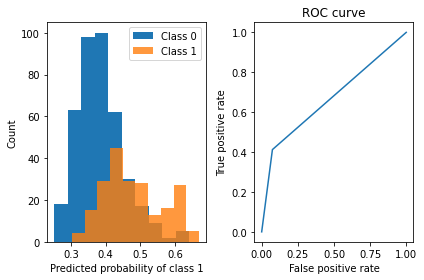

In [ ]:
# fit a rulefit model
model = BoostedRulesClassifier(n_estimators=10)
model.fit(X_train, y_train, feature_names=feat_names)

probs = model.predict_proba(X_test)
preds = model.predict(X_test)

# print the rule list
print("Classifier Accuracy:", np.mean(y_test == preds), "\n Learned interpretable model:\n", model)

# look at prediction breakdown
viz_classification_preds(probs, y_test)

### Ruletree

#### FIGSRegressor

In [ ]:
model = FIGSRegressor()  # initialize a model

model.fit(X_train_reg, y_train_reg, feature_names=feat_names_reg) # stores into m.rules_

# get test performance
preds = model.predict(X_test_reg)
print(f'test mse: {metrics.mean_squared_error(y_test_reg, preds):0.2f}')
print(f'test r2: {metrics.r2_score(y_test_reg, preds):0.2f}')

print(model) # print the rule-based model

test mse: 24.58
test r2: 0.72
------------
rm <= 6.833 (Tree #0 root)
	lstat <= 14.395 (split)
		dis <= 1.361 (split)
			Val: 50.000 (leaf)
			rm <= 6.535 (split)
				Val: 21.326 (leaf)
				Val: 27.644 (leaf)
		crim <= 7.952 (split)
			age <= 92.300 (split)
				Val: 19.013 (leaf)
				Val: 15.457 (leaf)
			dis <= 1.582 (split)
				Val: 7.462 (leaf)
				Val: 12.970 (leaf)
	rm <= 7.454 (split)
		Val: 32.233 (leaf)
		nox <= 0.535 (split)
			Val: 35.200 (leaf)
			Val: 50.000 (leaf)

	+
age <= 44.900 (Tree #1 root)
	Val: 1.611 (leaf)
	Val: -0.588 (leaf)

	+
crim <= 0.067 (Tree #2 root)
	age <= 79.850 (split)
		Val: -0.983 (leaf)
		Val: -8.442 (leaf)
	Val: 0.393 (leaf)



In [ ]:
feat_names_reg

Index(['crim', 'zn', 'indus', 'chas', 'nox', 'rm', 'age', 'dis', 'rad', 'tax',
       'ptratio', 'lstat'],
      dtype='object')

#### GreedyTreeRegressor

test mse: 26.44
test r2: 0.70


[Text(0.5, 0.875, 'X[5] <= 6.833\nsquared_error = 71.906\nsamples = 101\nvalue = 22.643'),
 Text(0.25, 0.625, 'X[11] <= 14.395\nsquared_error = 36.444\nsamples = 85\nvalue = 20.175'),
 Text(0.125, 0.375, 'X[7] <= 1.361\nsquared_error = 25.52\nsamples = 56\nvalue = 22.854'),
 Text(0.0625, 0.125, 'squared_error = 0.0\nsamples = 1\nvalue = 50.0'),
 Text(0.1875, 0.125, 'squared_error = 12.342\nsamples = 55\nvalue = 22.36'),
 Text(0.375, 0.375, 'X[0] <= 7.952\nsquared_error = 16.938\nsamples = 29\nvalue = 15.003'),
 Text(0.3125, 0.125, 'squared_error = 7.245\nsamples = 18\nvalue = 17.283'),
 Text(0.4375, 0.125, 'squared_error = 10.377\nsamples = 11\nvalue = 11.273'),
 Text(0.75, 0.625, 'X[5] <= 7.454\nsquared_error = 56.158\nsamples = 16\nvalue = 35.75'),
 Text(0.625, 0.375, 'X[0] <= 0.063\nsquared_error = 11.719\nsamples = 12\nvalue = 32.233'),
 Text(0.5625, 0.125, 'squared_error = 14.44\nsamples = 2\nvalue = 27.4'),
 Text(0.6875, 0.125, 'squared_error = 5.568\nsamples = 10\nvalue = 33.2')

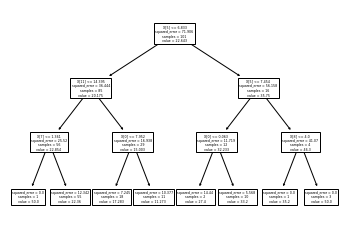

In [ ]:
model = GreedyTreeRegressor(max_depth=3)

model.fit(X_train_reg, y_train_reg, feature_names=feat_names_reg) # stores into m.rules_

# get test performance
preds = model.predict(X_test_reg)
print(f'test mse: {metrics.mean_squared_error(y_test_reg, preds):0.2f}')
print(f'test r2: {metrics.r2_score(y_test_reg, preds):0.2f}')

plot_tree(model)

For more information, please refer to https://github.com/csinva/imodels

## Partial Depedency Plot and Individual Conditional Expectation plots

Partial dependence plots (PDP) and individual conditional expectation (ICE) plots can be used to visualize and analyze interaction between the target response 1 and a set of input features of interest.

Both PDPs and ICEs **assume that the input features of interest are independent from the complement features**, and this assumption is often violated in practice. Thus, in the case of correlated features, we will create absurd data points to compute the PDP/ICE.

### Partial dependence plots

Partial dependence plots (PDP) show the dependence between the target response and a set of input features of interest, **marginalizing over the values of all other input features (the ‘complement’ features).** Intuitively, we can interpret the partial dependence as the expected target response as a function of the input features of interest.

Due to the limits of human perception the size of the set of input feature of interest must be small (usually, one or two) **thus the input features of interest are usually chosen among the most important features.**



In [ ]:
cal_housing = fetch_california_housing()
X = pd.DataFrame(cal_housing.data, columns=cal_housing.feature_names)
y = cal_housing.target

y -= y.mean()

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=0)

#### 1-way partial dependence with different models

Note that it is important to **check that the model is accurate enough on a test set before plotting the partial dependence** since there would be little use in explaining the impact of a given feature on the prediction function of a poor model.

In [ ]:
est = HistGradientBoostingRegressor(random_state=0)
est.fit(X_train, y_train)
print(f"Test R2 score: {est.score(X_test, y_test):.2f}")

Test R2 score: 0.85


The `sklearn.inspection` module provides a convenience function `from_estimator` to create one-way and two-way partial dependence plots.

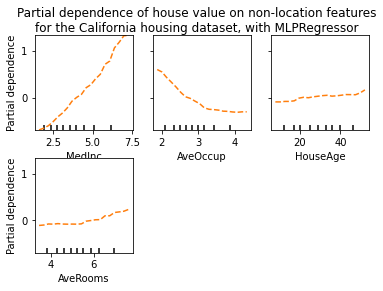

In [ ]:
features = ["MedInc", "AveOccup", "HouseAge", "AveRooms"]
display = PartialDependenceDisplay.from_estimator(
    est,
    X_train,
    features,
    grid_resolution=20,
    random_state=0,
    pd_line_kw={"color": "tab:orange", "linestyle": "--"}
)
display.figure_.suptitle(
    "Partial dependence of house value on non-location features\n"
    "for the California housing dataset, with MLPRegressor"
)
display.figure_.subplots_adjust(hspace=0.3)

We can clearly see on the PDPs (dashed orange line) that the median house price shows a linear relationship with the median income (top left) and that the house price drops when the average occupants per household increases (top middle). The top right plot shows that the house age in a district does not have a strong influence on the (median) house price; so does the average rooms per household.

One-way PDPs tell us about the interaction between the target response and an input feature of interest feature (e.g. linear, non-linear). 

#### 2D Partial Dependence Plots

PDPs with two features of interest enable us to visualize interactions among them. Another consideration is linked to the performance to compute the PDPs. With the tree-based algorithm, when only PDPs are requested, they can be computed on an efficient way using the 'recursion' method.

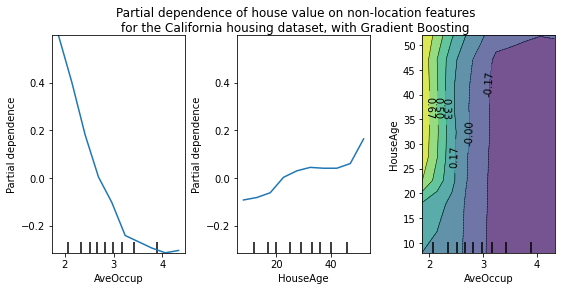

In [ ]:
features = ["AveOccup", "HouseAge", ("AveOccup", "HouseAge")]
_, ax = plt.subplots(ncols=3, figsize=(9, 4))
display = PartialDependenceDisplay.from_estimator(
    est,
    X_train,
    features,
    kind="average",
    grid_resolution=10,
    ax=ax,
)

display.figure_.suptitle(
    "Partial dependence of house value on non-location features\n"
    "for the California housing dataset, with Gradient Boosting"
)
display.figure_.subplots_adjust(wspace=0.4, hspace=0.3)

The left plot in the above figure shows the effect of the average occupancy on the median house price; we can clearly see a linear relationship among them when the average occupancy is inferior to 3 persons. Similarly, we could analyze the effect of the house age on the median house price (middle plot). Thus, these interpretations are marginal, considering a feature at a time.

The two-way partial dependence plot shows the dependence of median house price on joint values of house age and average occupants per household. We can clearly see an interaction between the two features: for an average occupancy greater than two, the house price is nearly independent of the house age, whereas for values less than two there is a strong dependence on age.

If you need the raw values of the partial dependence function rather than the plots, you can use the `sklearn.inspection.partial_dependenc`e function.

#### Another example

Like permutation importance, partial dependence plots are calculated **after a model has been fit.** The model is fit on real data that has not been artificially manipulated in any way. Our example will use a model that predicts whether a soccer/football team will have the "Man of the Game" winner based on the team's statistics. The "Man of the Game" award is given to the best player in the game. 

Teams may differ in many ways. How many passes they made, shots they took, goals they scored, etc. At first glance, it seems difficult to disentangle the effect of these features. To see how partial plots separate out the effect of each feature, we start by considering a single row of data. For example, that row of data might represent a team that had the ball 50% of the time, made 100 passes, took 10 shots and scored 1 goal.

We will use the fitted model to predict our outcome (probability their player won "man of the match"). **But we repeatedly alter the value for one variable to make a series of predictions.** We could predict the outcome if the team had the ball only 40% of the time. We then predict with them having the ball 50% of the time. Then predict again for 60%. And so on. We trace out predicted outcomes (on the vertical axis) as we move from small values of ball possession to large values (on the horizontal axis).

In this description, we used only a single row of data. Interactions between features may cause the plot for a single row to be atypical. So, we repeat that mental experiment with multiple rows from the original dataset, and we plot the average predicted outcome on the vertical axis.

In [ ]:
data = pd.read_csv('FIFA 2018 Statistics.csv')
y = (data['Man of the Match'] == "Yes")  # Convert from string "Yes"/"No" to binary
feature_names = [i for i in data.columns if data[i].dtype in [np.int64]]
X = data[feature_names]
X

,Goal Scored,Ball Possession %,Attempts,On-Target,Off-Target,Blocked,Corners,Offsides,Free Kicks,Saves,Pass Accuracy %,Passes,Distance Covered (Kms),Fouls Committed,Yellow Card,Yellow & Red,Red,Goals in PSO
0,5,40,13,7,3,3,6,3,11,0,78,306,118,22,0,0,0,0
1,0,60,6,0,3,3,2,1,25,2,86,511,105,10,0,0,0,0
2,0,43,8,3,3,2,0,1,7,3,78,395,112,12,2,0,0,0
3,1,57,14,4,6,4,5,1,13,3,86,589,111,6,0,0,0,0
4,0,64,13,3,6,4,5,0,14,2,86,433,101,22,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123,1,46,11,1,6,4,4,3,24,5,79,479,148,14,1,0,0,0
124,2,43,12,4,3,5,4,1,5,5,88,510,108,11,1,0,0,0
125,0,57,15,5,7,3,5,0,12,2,92,698,110,5,2,0,0,0
126,4,39,8,6,1,1,2,1,14,1,75,271,99,14,2,0,0,0


In [ ]:
train_X, val_X, train_y, val_y = train_test_split(X, y, random_state=1)
tree_model = DecisionTreeClassifier(random_state=0, max_depth=5, min_samples_split=5).fit(train_X, train_y)

Our first example uses a decision tree, which you can see below. In practice, you'll use more sophistated models for real-world applications.

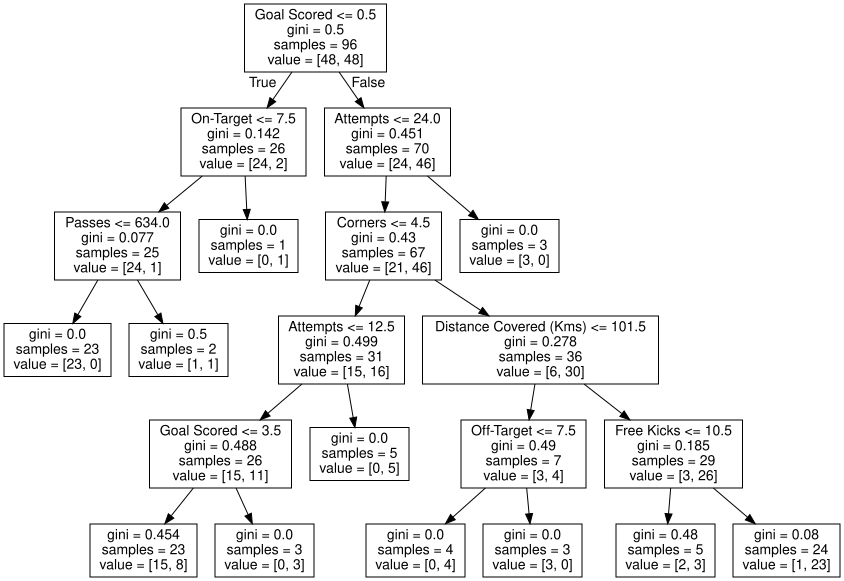

In [ ]:
tree_graph = tree.export_graphviz(tree_model, out_file=None, feature_names=feature_names)
graphviz.Source(tree_graph)

In [ ]:
feature_names

['Goal Scored',
 'Ball Possession %',
 'Attempts',
 'On-Target',
 'Off-Target',
 'Blocked',
 'Corners',
 'Offsides',
 'Free Kicks',
 'Saves',
 'Pass Accuracy %',
 'Passes',
 'Distance Covered (Kms)',
 'Fouls Committed',
 'Yellow Card',
 'Yellow & Red',
 'Red',
 'Goals in PSO']

(0.0, 1.0)

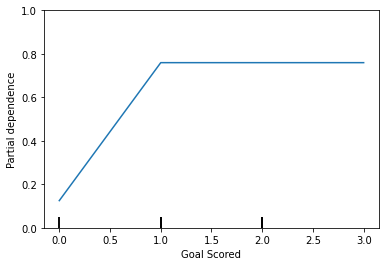

In [ ]:
PartialDependenceDisplay.from_estimator(tree_model, val_X, features=['Goal Scored'], feature_names=feature_names)
plt.ylim(0,1)

A few items are worth pointing out as you interpret this plot

* The y axis is interpreted as **change in the prediction** from what it would be predicted at the baseline or leftmost value.
* A blue shaded area indicates level of confidence

From this particular graph, we see that scoring a goal substantially increases your chances of winning "Man of The Match."  But extra goals beyond that appear to have little impact on predictions.

Here is another example plot:

(0.0, 2.0)

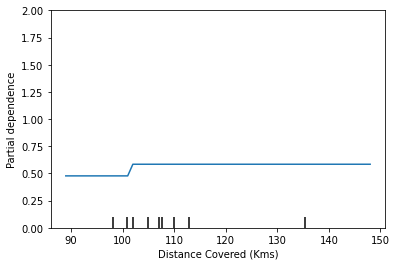

In [ ]:
PartialDependenceDisplay.from_estimator(tree_model, val_X, features=['Distance Covered (Kms)'], feature_names=feature_names)
plt.ylim(0,2)

This graph seems too simple to represent reality. But that's because the model is so simple. You should be able to see from the decision tree above that this is representing exactly the model's structure.

You can easily compare the structure or implications of different models. Here is the same plot with a Random Forest model.

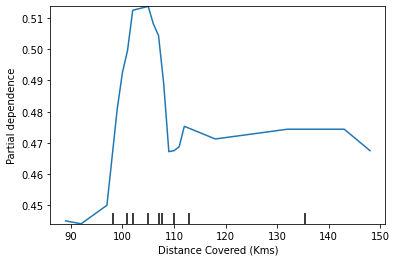

In [ ]:
# Build Random Forest model
rf_model = RandomForestClassifier(random_state=0).fit(train_X, train_y)

PartialDependenceDisplay.from_estimator(rf_model, val_X, features=['Distance Covered (Kms)'], feature_names=feature_names)


This model thinks you are more likely to win *Man of the Match* if your players run a total of 100km over the course of the game. Though running much more causes lower predictions.

In general, the smooth shape of this curve seems more plausible than the step function from the Decision Tree model.  Though this dataset is small enough that we would be careful in how we interpret any model.

If you are curious about interactions between features, 2D partial dependence plots are also useful. An example may clarify this.  

We will again use the Decision Tree model for this graph.  It will create an extremely simple plot, but you should be able to match what you see in the plot to the tree itself.

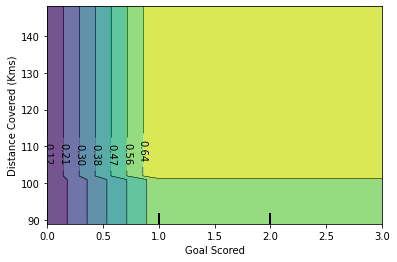

In [ ]:
# Similar to previous PDP plot
PartialDependenceDisplay.from_estimator(tree_model, val_X, features=[('Goal Scored', 'Distance Covered (Kms)')], feature_names=feature_names)

This graph shows predictions for any combination of Goals Scored and Distance covered.

For example, we see the highest predictions when a team scores at least 1 goal and they run a total distance close to 100km. If they score 0 goals, distance covered doesn't matter. Can you see this by tracing through the decision tree with 0 goals?

But distance can impact predictions if they score goals. Make sure you can see this from the 2D partial dependence plot. Can you see this pattern in the decision tree too?

###  Individual conditional expectation (ICE) plot

Due to the limits of human perception, **only one input feature** of interest is supported for ICE plots.

While the PDPs are good at showing the average effect of the target features, they can obscure a **heterogeneous relationship** created by interactions. When interactions are present the ICE plot will provide many more insights. For example, we could observe a linear relationship between the median income and the house price in the PD line. However, the ICE lines show that there are some exceptions, where the house price remains constant in some ranges of the median income. We will plot the partial dependence, both individual (ICE) and averaged one (PDP). We limit to only 50 ICE curves to not overcrowd the plot.

The sklearn.inspection module’s `PartialDependenceDisplay.from_estimator `convenience function can be used to create ICE plots by setting `kind='individual'`. But in ICE plots it might not be easy to see the average effect of the input feature of interest. Hence, it is recommended to use ICE plots alongside PDPs. They can be plotted together with `kind='both'`.

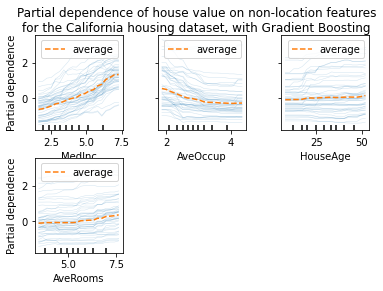

In [ ]:
features = ["MedInc", "AveOccup", "HouseAge", "AveRooms"]
display = PartialDependenceDisplay.from_estimator(
    est,
    X_train,
    features,
    kind="both",
    subsample=50,
    n_jobs=3,
    grid_resolution=20,
    random_state=0,
    ice_lines_kw={"color": "tab:blue", "alpha": 0.2, "linewidth": 0.5},
    pd_line_kw={"color": "tab:orange", "linestyle": "--"},
)
display.figure_.suptitle(
    "Partial dependence of house value on non-location features\n"
    "for the California housing dataset, with Gradient Boosting"
)
display.figure_.subplots_adjust(wspace=0.4, hspace=0.3)

The ICE curves (light blue lines) complement the analysis: we can see that there are some exceptions, where the house price remain constant with median income and average occupants. On the other hand, while the house age (top right) does not have a strong influence on the median house price on average, **there seems to be a number of exceptions where the house price increase when between the ages 15-25.** Similar exceptions can be observed for the average number of rooms (bottom left). Therefore, ICE plots show some individual effect which are attenuated by taking the averages.

Checkout more information at https://scikit-learn.org/stable/modules/partial_dependence.html# or https://github.com/SauceCat/PDPbox

## LIME

We'll use the Iris dataset, and we'll train a random forest.

In [ ]:
np.random.seed(1)
iris = load_iris()
train, test, labels_train, labels_test = train_test_split(iris.data, iris.target, train_size=0.8)

In [ ]:
rf = RandomForestClassifier(n_estimators=500)
rf.fit(train, labels_train)
metrics.accuracy_score(labels_test, rf.predict(test))

0.9666666666666667

### Tabular data

#### Create the explainer

Tabular explainers need a training set. The reason for this is because we compute statistics on each feature (column). If the feature is numerical, we compute the mean and std, and discretize it into quartiles. If the feature is categorical, we compute the frequency of each value. For this part, we'll only look at numerical features.

We use these computed statistics for two things:

1. To scale the data, so that we can meaningfully compute distances when the attributes are not on the same scale
2. To sample perturbed instances - which we do by sampling from a `Normal(0,1)`, multiplying by the std and adding back the mean.

In [ ]:
explainer = lime.lime_tabular.LimeTabularExplainer(train, feature_names=iris.feature_names, class_names=iris.target_names, discretize_continuous=True)

#### Explaining an instance

Since this is a multi-class classification problem, we set the `top_labels` parameter, so that we only explain the top class.

In [ ]:
i = np.random.randint(0, test.shape[0])
exp = explainer.explain_instance(test[i], rf.predict_proba, num_features=2, top_labels=1)

We now explain a single instance:

In [ ]:
exp.show_in_notebook(show_table=True, show_all=False)

Now, there is a lot going on here. First, note that the row we are explained is displayed on the right side, in table format. Since we had the `show_all` parameter set to false, only the features used in the explanation are displayed.
The value column displays the original value for each feature.

Note that LIME has discretized the features in the explanation. This is because we let `discretize_continuous=True` in the constructor (this is the default). Discretized features make for more intuitive explanations.

#### Checking the local linear approximation

In [ ]:
feature_index = lambda x: iris.feature_names.index(x)

In [ ]:
print('Increasing petal width')
temp = test[i].copy()
print('P(setosa) before:', rf.predict_proba(temp.reshape(1,-1))[0,0])
temp[feature_index('petal width (cm)')] = 1.5
print('P(setosa) after:', rf.predict_proba(temp.reshape(1,-1))[0,0])
print ()
print('Increasing petal length')
temp = test[i].copy()
print('P(setosa) before:', rf.predict_proba(temp.reshape(1,-1))[0,0])
temp[feature_index('petal length (cm)')] = 3.5
print('P(setosa) after:', rf.predict_proba(temp.reshape(1,-1))[0,0])
print()
print('Increasing both')
temp = test[i].copy()
print('P(setosa) before:', rf.predict_proba(temp.reshape(1,-1))[0,0])
temp[feature_index('petal width (cm)')] = 1.5
temp[feature_index('petal length (cm)')] = 3.5
print('P(setosa) after:', rf.predict_proba(temp.reshape(1,-1))[0,0])

Increasing petal width
P(setosa) before: 1.0
P(setosa) after: 0.482

Increasing petal length
P(setosa) before: 1.0
P(setosa) after: 0.55

Increasing both
P(setosa) before: 1.0
P(setosa) after: 0.032


Note that both features had the impact we thought they would. The scale at which they need to be perturbed of course depends on the scale of the feature in the training set.

### Image data

In [ ]:
inet_model = keras.applications.inception_v3.InceptionV3()

Instructions for updating:
Colocations handled automatically by placer.


In [ ]:
!wget https://raw.githubusercontent.com/marcotcr/lime/master/doc/notebooks/data/cat_mouse.jpg

--2022-05-13 10:25:27--  https://raw.githubusercontent.com/marcotcr/lime/master/doc/notebooks/data/cat_mouse.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 248960 (243K) [image/jpeg]
Saving to: ‘cat_mouse.jpg.1’

cat_mouse.jpg.1     100%[===================>] 243.12K  --.-KB/s    in 0.03s   

2022-05-13 10:25:28 (7.51 MB/s) - ‘cat_mouse.jpg.1’ saved [248960/248960]



In [ ]:
def transform_img_fn(path_list):
    out = []
    for img_path in path_list:
        img = keras.preprocessing.image.load_img(img_path, target_size=(299, 299))
        x = keras.preprocessing.image.img_to_array(img)
        x = np.expand_dims(x, axis=0)
        x = keras.applications.inception_v3.preprocess_input(x)
        out.append(x)
    return np.vstack(out)

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


('n02133161', 'American_black_bear', 0.6371607)
('n02105056', 'groenendael', 0.031817958)
('n02104365', 'schipperke', 0.029944286)
('n01883070', 'wombat', 0.028509347)
('n01877812', 'wallaby', 0.025093453)


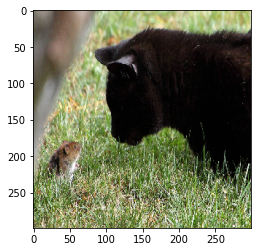

In [ ]:
images = transform_img_fn(['cat_mouse.jpg'])
# I'm dividing by 2 and adding 0.5 because of how this Inception represents images
plt.imshow(images[0] / 2 + 0.5)
preds = inet_model.predict(images)
for x in keras.applications.imagenet_utils.decode_predictions(preds)[0]:
    print(x)

#### Explanation

Now let's get an explanation

In [ ]:
explainer = lime_image.LimeImageExplainer()

In [ ]:
# Hide color is the color for a superpixel turned OFF. Alternatively, if it is NONE, the superpixel will be replaced by the average of its pixels
explanation = explainer.explain_instance(images[0].astype('double'), inet_model.predict, top_labels=5, hide_color=0, num_samples=1000)

  0%|          | 0/1000 [00:00<?, ?it/s]

#### Now let's see the explanation for the classes

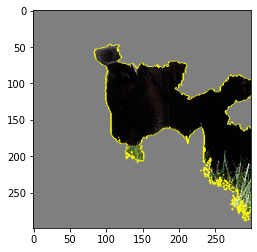

In [ ]:
temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, num_features=5, hide_rest=True)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

We can also see the 'pros and cons' (pros in green, cons in red)

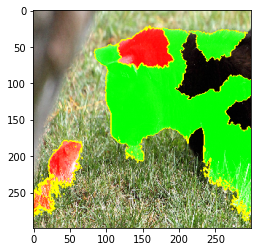

In [ ]:
temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

Alternatively, we can also plot explanation weights onto a heatmap visualization. The colorbar shows the values of the weights.

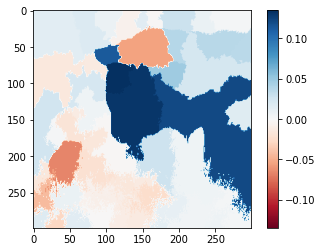

In [ ]:
#Select the same class explained on the figures above.
ind =  explanation.top_labels[0]

#Map each explanation weight to the corresponding superpixel
dict_heatmap = dict(explanation.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanation.segments) 

#Plot. The visualization makes more sense if a symmetrical colorbar is used.
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max())
plt.colorbar()

Let's see the explanation for the wombat

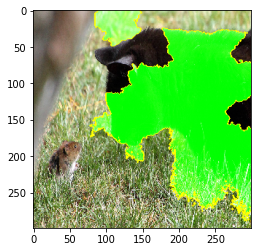

In [ ]:
temp, mask = explanation.get_image_and_mask(explanation.top_labels[3], positive_only=False, num_features=10, hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

For more information, please refer to https://github.com/marcotcr/lime

## SHAP

### The force plot

An example is helpful, and we'll continue the soccer/football example from the partial dependence plots. In these part, we predicted whether **a team would have a player win the Man of the Match award.**

We could ask:
* How much was a prediction driven by the fact that the team scored 3 goals?

But it's easier to give a concrete, numeric answer if we restate this as:
* How much was a prediction driven by the fact that the team scored 3 goals, instead of some baseline number of goals.

Of course, each team has many features. So if we answer this question for number of goals, we could repeat the process for all other features.

In [ ]:
data = pd.read_csv('FIFA 2018 Statistics.csv')
y = (data['Man of the Match'] == "Yes")  # Convert from string "Yes"/"No" to binary
feature_names = [i for i in data.columns if data[i].dtype in [np.int64, np.int64]]
X = data[feature_names]
train_X, val_X, train_y, val_y = train_test_split(X, y, random_state=1)
my_model = RandomForestClassifier(random_state=0).fit(train_X, train_y)

We will look at SHAP values for a single row of the dataset (we arbitrarily chose row 5). For context, we'll look at the raw predictions before looking at the SHAP values.

In [ ]:
row_to_show = 5
data_for_prediction = val_X.iloc[row_to_show]  # use 1 row of data here. Could use multiple rows if desired
#data_for_prediction_array = data_for_prediction.values.reshape(1, -1)

my_model.predict_proba(data_for_prediction.values.reshape(1, -1))

X does not have valid feature names, but RandomForestClassifier was fitted with feature names


array([[0.29, 0.71]])

The team is 71% likely to have a player win the award. 
Now, we'll move onto the code to get SHAP values for that single prediction.

In [ ]:
# Create object that can calculate shap values
explainer = shap.Explainer(my_model)

# Calculate Shap values
shap_values = explainer.shap_values(data_for_prediction)

The `shap_values` object above is a list with two arrays. The first array is the SHAP values for a negative outcome (don't win the award), and the second array is the list of SHAP values for the positive outcome (wins the award). We typically think about predictions in terms of the prediction of a positive outcome, so we'll pull out SHAP values for positive outcomes (pulling out `shap_values[1]`).

It's cumbersome to review raw arrays, but the shap package has a nice way to visualize the results. 

In [ ]:
shap.initjs()
shap.plots.force(explainer.expected_value[1], shap_values[1], data_for_prediction)

If you look carefully at the code where we created the SHAP values, you'll notice we reference Trees in `shap.TreeExplainer(my_model)`.  But the SHAP package has explainers for every type of model.

* `shap.DeepExplainer` works with Deep Learning models. 
* `shap.KernelExplainer` works with all models, though it is slower than other Explainers and it offers an approximation rather than exact Shap values.

Here is an example using KernelExplainer to get similar results. The results aren't identical because `KernelExplainer` gives an approximate result. But the results tell the same story.

### Summary Plots

In addition to this nice breakdown for each prediction, the [Shap library](https://github.com/slundberg/shap) offers great visualizations of groups of Shap values. We will focus on two of these visualizations. These visualizations have conceptual similarities to permutation importance and partial dependence plots.

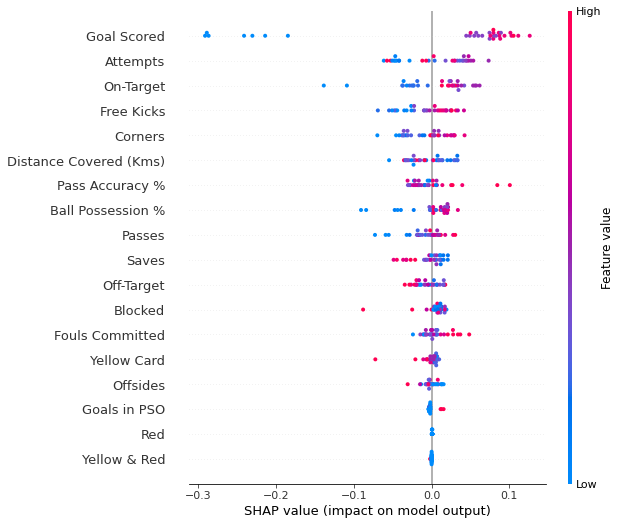

In [ ]:
# Calculate shap_values for all of val_X rather than a single row, to have more data for plot.
shap_values = explainer.shap_values(val_X)

# Make plot. Index of [1] is explained in text below.
shap.summary_plot(shap_values[1], val_X)

The code isn't too complex. But there are a few caveats.

* When plotting, we call `shap_values[1]`.  For classification problems, there is a separate array of SHAP values for each possible outcome. In this case, **we index in to get the SHAP values for the prediction of "True".**
* Calculating SHAP values can be slow. It isn't a problem here, because this dataset is small.  But you'll want to be careful when running these to plot with reasonably sized datasets.  The exception is when using an `xgboost` model, which SHAP has some optimizations for and which is thus much faster.

This provides a great overview of the model, but we might want to delve into a single feature. That's where SHAP dependence contribution plots come into play.

### Dependence Contribution Plots

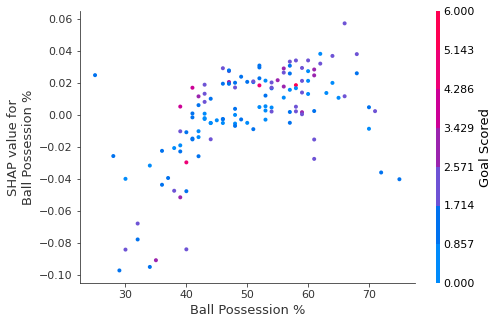

In [ ]:
# calculate shap values. This is what we will plot.
shap_values = explainer.shap_values(X)

# make plot.
shap.dependence_plot('Ball Possession %', shap_values[1], X, interaction_index="Goal Scored")

### Image data

Deep SHAP is a high-speed approximation algorithm for SHAP values in deep learning models that builds on a connection with DeepLIFT. The implementation here differs from the original DeepLIFT by using a distribution of background samples instead of a single reference value, and using Shapley equations to linearize components such as max, softmax, products, divisions, etc. Note that some of these enhancements have also been since integrated into DeepLIFT. 

**Currnetly, you need to restart the kernel and add `tf.compat.v1.disable_v2_behavior()` to run the following SHAP code. (see https://github.com/slundberg/shap/issues/2189.)**

In [63]:
batch_size = 128
num_classes = 10
epochs = 12

# input image dimensions
img_rows, img_cols = 28, 28

# the data, split between train and test sets
(x_train, y_train), (x_test, y_test) = keras.datasets.mnist.load_data()

x_train = x_train.reshape(x_train.shape[0], img_rows, img_cols, 1)
x_test = x_test.reshape(x_test.shape[0], img_rows, img_cols, 1)
input_shape = (img_rows, img_cols, 1)

x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
x_train /= 255
x_test /= 255
print('x_train shape:', x_train.shape)
print(x_train.shape[0], 'train samples')
print(x_test.shape[0], 'test samples')


model = keras.models.Sequential()
model.add(keras.layers.Conv2D(32, kernel_size=(3, 3),
                 activation='relu',
                 input_shape=input_shape))
model.add(keras.layers.Conv2D(64, (3, 3), activation='relu'))
model.add(keras.layers.MaxPooling2D(pool_size=(2, 2)))
model.add(keras.layers.Dropout(0.25))
model.add(keras.layers.Flatten())
model.add(keras.layers.Dense(128, activation='relu'))
model.add(keras.layers.Dropout(0.5))
model.add(keras.layers.Dense(num_classes, activation='softmax'))

model.compile(loss=keras.losses.sparse_categorical_crossentropy,
              optimizer=keras.optimizers.Adam(),
              metrics=['accuracy'])

model.fit(x_train, y_train,
          batch_size=batch_size,
          epochs=epochs,
          verbose=1,
          validation_data=(x_test, y_test))
score = model.evaluate(x_test, y_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

x_train shape: (60000, 28, 28, 1)
60000 train samples
10000 test samples
Train on 60000 samples, validate on 10000 samples
Epoch 1/12
60000/60000 [==============================] - ETA: 0s - loss: 0.2451 - acc: 0.9250

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


60000/60000 [==============================] - 8s 141us/sample - loss: 0.2451 - acc: 0.9250 - val_loss: 0.0532 - val_acc: 0.9820
Epoch 2/12
60000/60000 [==============================] - 8s 138us/sample - loss: 0.0881 - acc: 0.9738 - val_loss: 0.0370 - val_acc: 0.9875
Epoch 3/12
60000/60000 [==============================] - 8s 140us/sample - loss: 0.0655 - acc: 0.9805 - val_loss: 0.0297 - val_acc: 0.9897
Epoch 4/12
60000/60000 [==============================] - 8s 140us/sample - loss: 0.0529 - acc: 0.9837 - val_loss: 0.0305 - val_acc: 0.9896
Epoch 5/12
60000/60000 [==============================] - 8s 137us/sample - loss: 0.0451 - acc: 0.9862 - val_loss: 0.0288 - val_acc: 0.9896
Epoch 6/12
60000/60000 [==============================] - 8s 137us/sample - loss: 0.0394 - acc: 0.9879 - val_loss: 0.0247 - val_acc: 0.9917
Epoch 7/12
60000/60000 [==============================] - 7s 124us/sample - loss: 0.0349 - acc: 0.9888 - val_loss: 0.0235 - val_acc: 0.9916
Epoch 8/12
60000/60000 [=======

In [64]:
# select a set of background examples to take an expectation over
background = x_train[np.random.choice(x_train.shape[0], 100, replace=False)]

# explain predictions of the model on three images
e = shap.DeepExplainer(model, background)
# ...or pass tensors directly
# e = shap.DeepExplainer((model.layers[0].input, model.layers[-1].output), background)
shap_values = e.shap_values(x_test[1:5])

keras is no longer supported, please use tf.keras instead.
Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


In [67]:
len(shap_values)

10

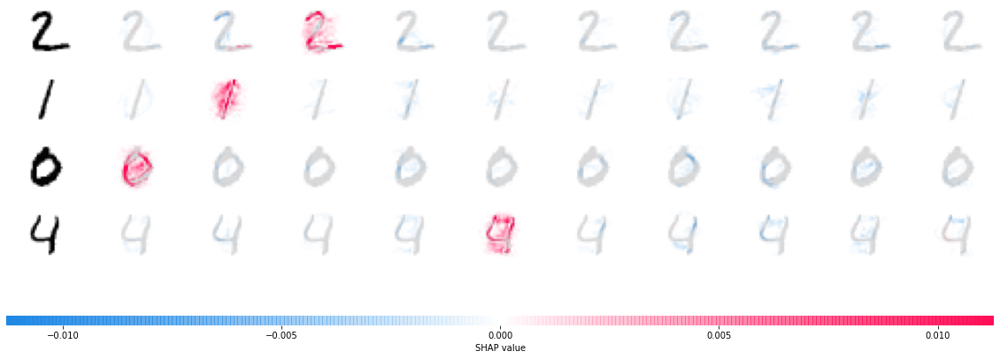

In [ ]:
# plot the feature attributions
# 10 classes, thus we have 10 plots!
shap.image_plot(shap_values, -x_test[1:5])

The plot above explains ten outputs (digits 0-9) for four different images. Red pixels increase the model's output while blue pixels decrease the output. The input images are shown on the left, and as nearly transparent grayscale backings behind each of the explanations. The sum of the SHAP values equals the difference between the expected model output (averaged over the background dataset) and the current model output. Note that for the 'zero' image the blank middle is important, while for the 'four' image the lack of a connection on top makes it a four instead of a nine.

## Visualize CNN using keras-viz

### Visualizing intermediate activations

In [ ]:
!wget https://raw.githubusercontent.com/keisen/tf-keras-vis/master/docs/examples/images/goldfish.jpg
!wget https://raw.githubusercontent.com/keisen/tf-keras-vis/master/docs/examples/images/bear.jpg
!wget https://raw.githubusercontent.com/keisen/tf-keras-vis/master/docs/examples/images/soldiers.jpg

--2022-05-13 11:20:37--  https://raw.githubusercontent.com/keisen/tf-keras-vis/master/docs/examples/images/goldfish.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 8833 (8.6K) [image/jpeg]
Saving to: ‘goldfish.jpg.2’

goldfish.jpg.2      100%[===================>]   8.63K  --.-KB/s    in 0s      

2022-05-13 11:20:37 (33.9 MB/s) - ‘goldfish.jpg.2’ saved [8833/8833]

--2022-05-13 11:20:37--  https://raw.githubusercontent.com/keisen/tf-keras-vis/master/docs/examples/images/bear.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.110.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length:

In [ ]:
# Load model
model = keras.applications.vgg16.VGG16(weights='imagenet', include_top=True)
model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [ ]:
def get_img_array(img_path, target_size):
    img = keras.utils.load_img(
        img_path, target_size=target_size)
    array = keras.utils.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return array

img_tensor = get_img_array("goldfish.jpg", target_size=(224, 224))

In [ ]:
layer_outputs = []
layer_names = []
for layer in model.layers:
    if isinstance(layer, (keras.layers.Conv2D, keras.layers.MaxPooling2D)):
        layer_outputs.append(layer.output)
        layer_names.append(layer.name)
activation_model = keras.Model(inputs=model.input, outputs=layer_outputs)

In [ ]:
activations = activation_model.predict(img_tensor)

In [ ]:
first_layer_activation = activations[0]
print(first_layer_activation.shape)

(1, 224, 224, 64)


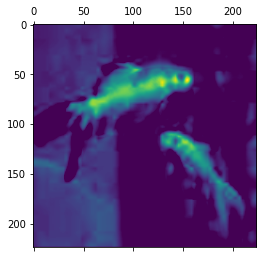

In [ ]:
plt.matshow(first_layer_activation[0, :, :, 5], cmap="viridis")

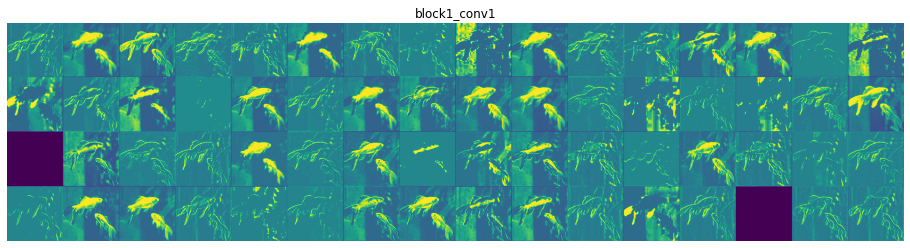

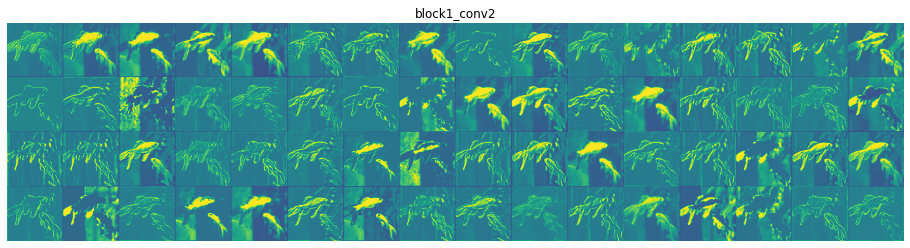

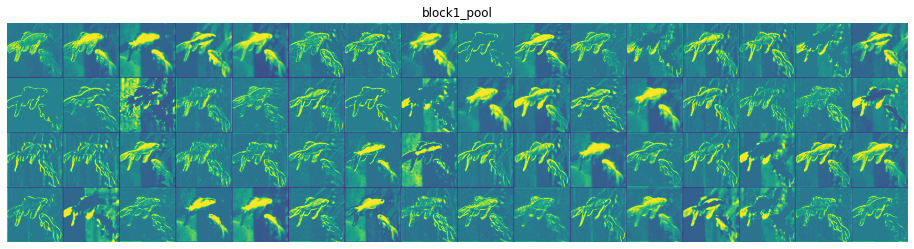

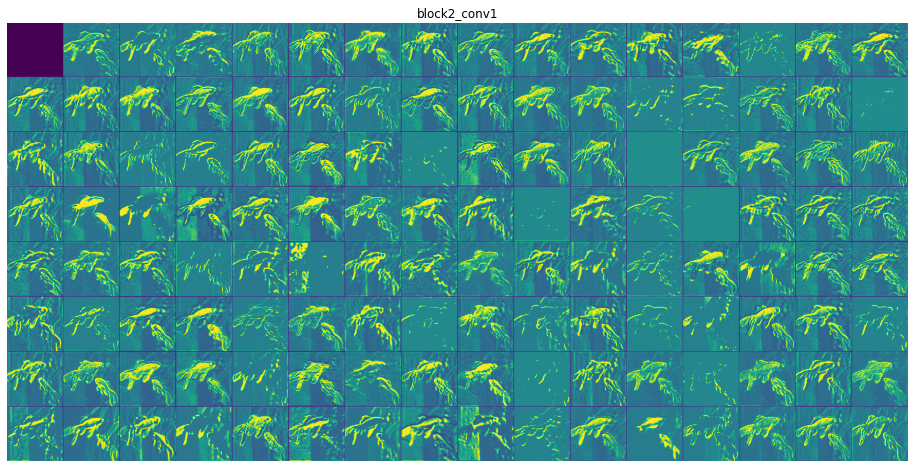

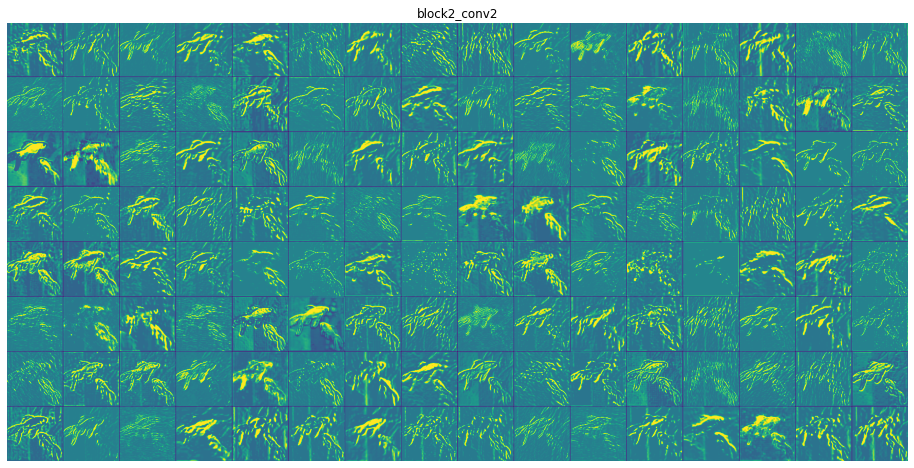

...

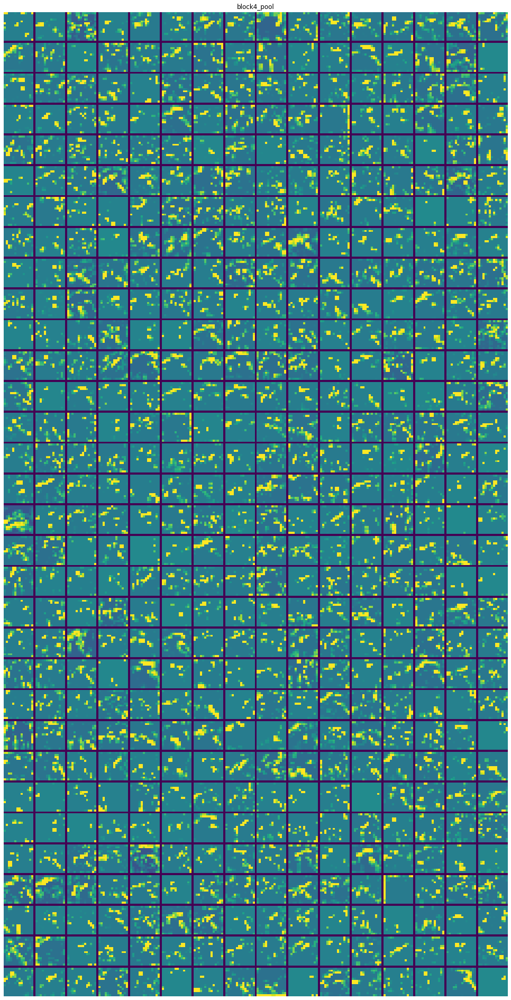

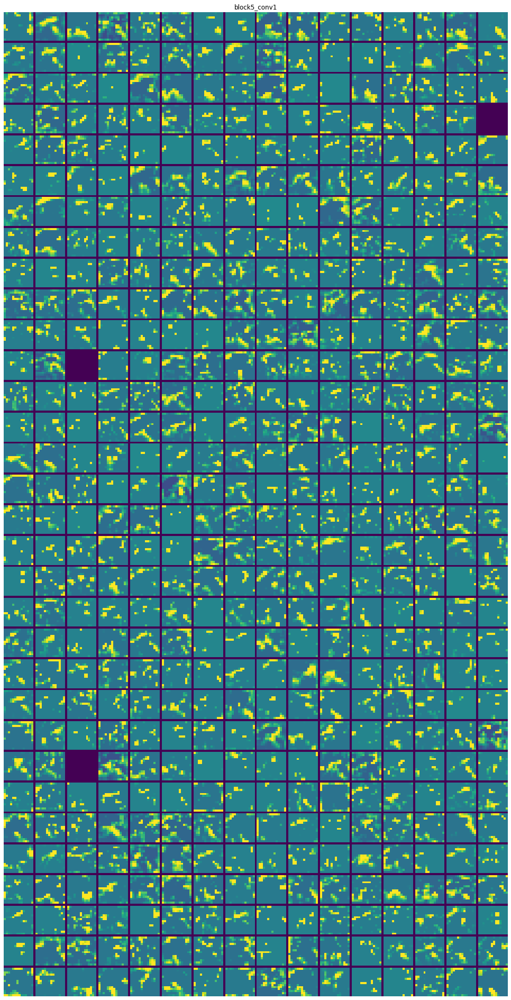

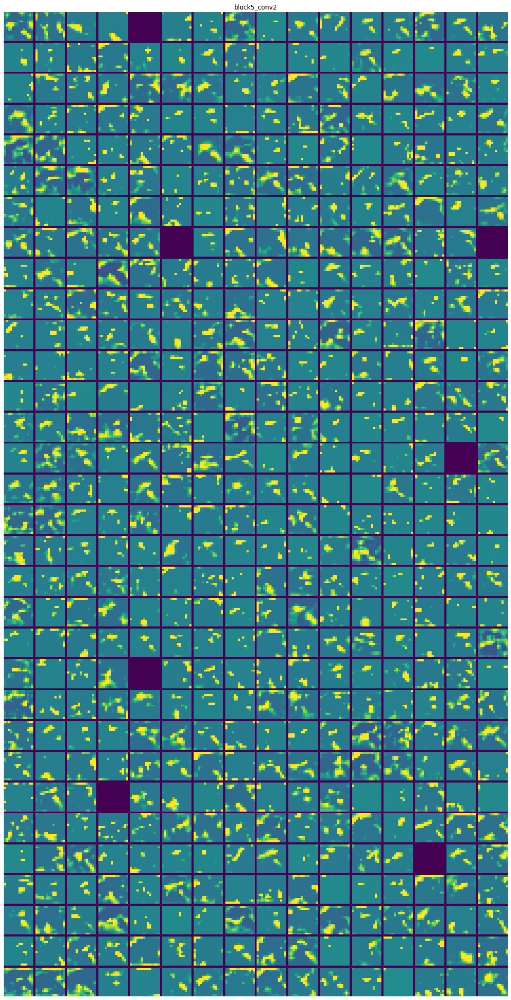

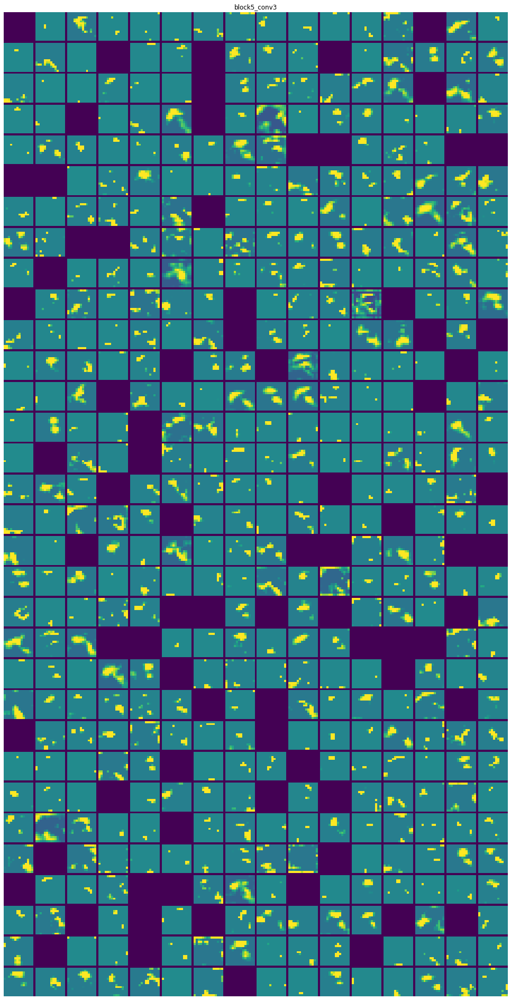

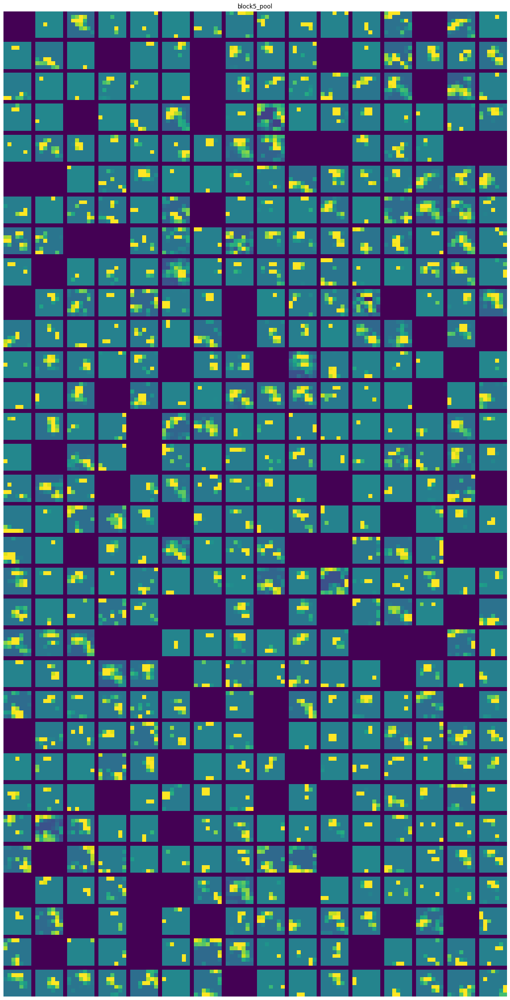

In [ ]:
images_per_row = 16
for layer_name, layer_activation in zip(layer_names, activations):
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_cols = n_features // images_per_row
    display_grid = np.zeros(((size + 1) * n_cols - 1,
                             images_per_row * (size + 1) - 1))
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_index = col * images_per_row + row
            channel_image = layer_activation[0, :, :, channel_index].copy()
            if channel_image.sum() != 0:
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype("uint8")
            display_grid[
                col * (size + 1): (col + 1) * size + col,
                row * (size + 1) : (row + 1) * size + row] = channel_image
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.axis("off")
    plt.imshow(display_grid, aspect="auto", cmap="viridis")

### Visualizing Conv filters using ActivationMaximization

#### Model modifier

You MUST define a model modifier to replace the model output to target layer's output that has filters you want to visualize, and , in addion, replace the function of it to a linear activation function.

Although we create and use `ExtractIntermediateLayer` and `ReplaceToLinear `instance, we can also use the model modifier function defined by ourselves.

In [ ]:
#tf.compat.v1.enable_eager_execution()
model = keras.applications.vgg16.VGG16(weights='imagenet', include_top=True)
layer_name = 'block5_conv3' # The target layer that is the last layer of VGG16.

# This instance constructs new model whose output is replaced to `block5_conv3` layer's output.
extract_intermediate_layer = ExtractIntermediateLayer(index_or_name=layer_name)
# This instance modify the model's last activation function to linear one.
replace2linear = ReplaceToLinear()

# Instead of using ExtractIntermediateLayer and ReplaceToLinear instance,
# you can also define the function from scratch as follows:
def model_modifier_function(current_model):
    target_layer = current_model.get_layer(name=layer_name)
    target_layer.activation = tf.keras.activations.linear
    new_model = tf.keras.Model(inputs=current_model.inputs,
                               outputs=target_layer.output)
    return new_model

#### Score function

You MUST create Score instance or define score function that returns target scores. Here, they return the value of 3rd filter in block5_conv3 layer.

In [ ]:
filter_number = 3
score = CategoricalScore(filter_number)

# Instead of using CategoricalScore object above,
# you can also define the function from scratch as follows:
def score_function(output):
    return output[..., filter_number]

#### Create Seed-Input values

You MUST create `seed_input` value. In default, when visualizing a specific filter, tf-keras-vis automatically generates seed_input to visualize a image. When visualizing multiple images, you MUST manually create `seed_input`.

In [ ]:
# Define seed inputs whose shape is (samples, height, width, channels).
# seed_input = tf.random.uniform((3, 224, 224, 3), 0, 255)

#### Create ActivationMaximization Instnace

When `clone` argument is True(default), the model will be cloned, so the model instance will be NOT modified, however the process may take a while.

Here, because the `ExtractIntermediateLayer` instance will construct new model, setting False.

In [ ]:
activation_maximization = ActivationMaximization(model,
        # Please note that `extract_intermediate_layer` has to come before `replace2linear`.
        model_modifier=[extract_intermediate_layer, replace2linear],
        clone=False)

ActivationMaximization will maximize the value computed by the score function. Here, we will visualize the 63rd convolutional filter.

200/200 [==============================] - 23s 112ms/step - Score: 823.8959 - TotalVariation2D: 22.7696 - Norm: 39.7871


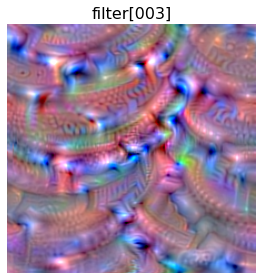

In [ ]:
# Generate maximized activation
activations = activation_maximization(score, callbacks=[Progress()])

## Since v0.6.0, calling `astype()` is NOT necessary.

# Render
f, ax = plt.subplots(figsize=(4, 4))
ax.imshow(activations[0])
ax.set_title('filter[{:03d}]'.format(filter_number), fontsize=16)
ax.axis('off')
plt.tight_layout()
plt.show()

### Visualize heatmaps of class activation in an image 

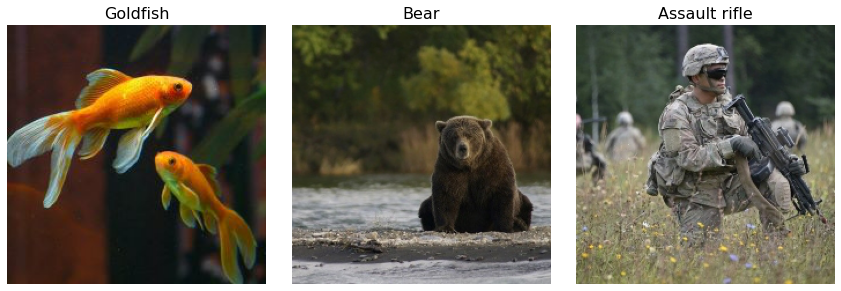

In [ ]:
# Image titles
image_titles = ['Goldfish', 'Bear', 'Assault rifle']

# Load images and Convert them to a Numpy array
img1 = keras.preprocessing.image.load_img('goldfish.jpg', target_size=(224, 224))
img2 = keras.preprocessing.image.load_img('bear.jpg', target_size=(224, 224))
img3 = keras.preprocessing.image.load_img('soldiers.jpg', target_size=(224, 224))
images = np.asarray([np.array(img1), np.array(img2), np.array(img3)])

# Preparing input data for VGG16
X = keras.applications.vgg16.preprocess_input(images)

# Rendering
f, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
for i, title in enumerate(image_titles):
    ax[i].set_title(title, fontsize=16)
    ax[i].imshow(images[i])
    ax[i].axis('off')
plt.tight_layout()
plt.show()

#### Model modifier

When the softmax activation function is applied to the last layer of model, it may obstruct generating the attention images, so you should replace the function to a linear activation function. Although we create and use ReplaceToLinear instance here, we can also use the model modifier function defined by ourselves.

In [ ]:
replace2linear = ReplaceToLinear()

# Instead of using the ReplaceToLinear instance above,
# you can also define the function from scratch as follows:
def model_modifier_function(cloned_model):
    cloned_model.layers[-1].activation = tf.keras.activations.linear

#### Score function

And then, you MUST create Score instance or define score function that returns target scores. Here, they return the score values corresponding Goldfish, Bear, Assault Rifle.

In [ ]:
# 1 is the imagenet index corresponding to Goldfish, 294 to Bear and 413 to Assault Rifle.
score = CategoricalScore([1, 294, 413])

# Instead of using CategoricalScore object,
# you can also define the function from scratch as follows:
def score_function(output):
    # The `output` variable refers to the output of the model,
    # so, in this case, `output` shape is `(3, 1000)` i.e., (samples, classes).
    return (output[0][1], output[1][294], output[2][413])

#### Vanilla Saliency

Saliency generates a saliency map that appears the regions of ​​the input image that contributes the most to the output value.

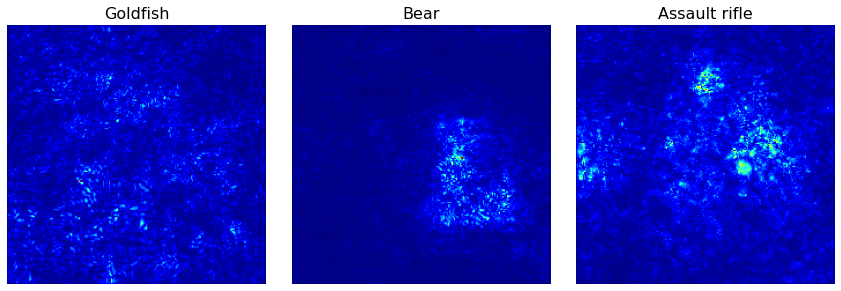

In [ ]:
# Create Saliency object.
model = keras.applications.vgg16.VGG16(weights='imagenet', include_top=True)
saliency = Saliency(model,
      model_modifier=replace2linear,
      clone=True)

# Generate saliency map
saliency_map = saliency(score, X)

## Since v0.6.0, calling `normalize()` is NOT necessary.
# saliency_map = normalize(saliency_map)

# Render
f, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
for i, title in enumerate(image_titles):
    ax[i].set_title(title, fontsize=16)
    ax[i].imshow(saliency_map[i], cmap='jet')
    ax[i].axis('off')
plt.tight_layout()
plt.show()

#### SmoothGrad

As you can see above, Vanilla Saliency map is too noisy, so let's remove noise in the saliency map using SmoothGrad! SmoothGrad is a method that reduce the noise in saliency map by adding noise to input image.

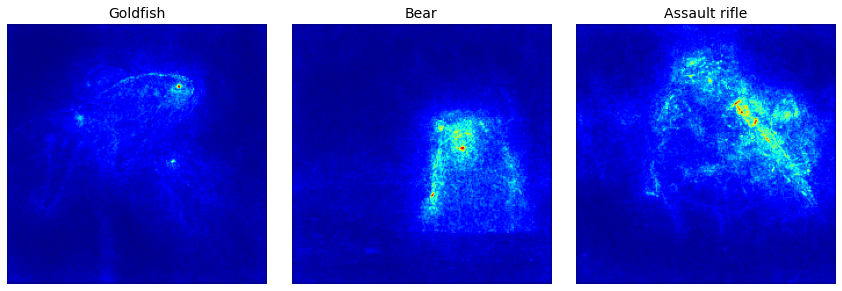

In [ ]:
# Generate saliency map with smoothing that reduce noise by adding noise
model = keras.applications.vgg16.VGG16(weights='imagenet', include_top=True)
saliency = Saliency(model,
      model_modifier=replace2linear,
      clone=True)

saliency_map = saliency(score,
                        X,
                        smooth_samples=20, # The number of calculating gradients iterations.
                        smooth_noise=0.20) # noise spread level.

## Since v0.6.0, calling `normalize()` is NOT necessary.
# saliency_map = normalize(saliency_map)

# Render
f, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
for i, title in enumerate(image_titles):
    ax[i].set_title(title, fontsize=14)
    ax[i].imshow(saliency_map[i], cmap='jet')
    ax[i].axis('off')
plt.tight_layout()
plt.show()

#### GradCAM

Saliency is one of useful way of visualizing attention that appears the regions of the input image that contributes the most to the output value. GradCAM is another way of visualizing attention over input. Instead of using gradients of model outputs, it uses of penultimate layer output (that is the convolutional layer just before Dense layers).

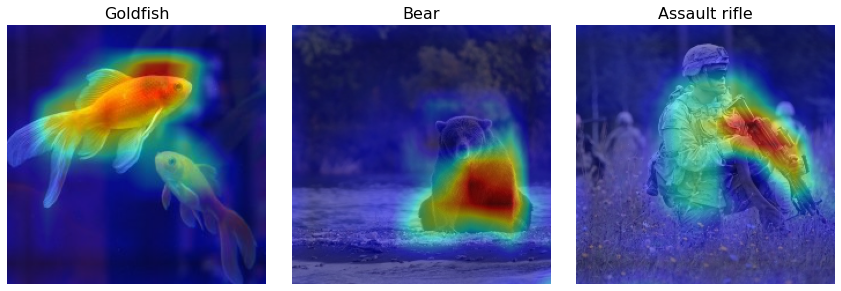

In [ ]:
# Create Gradcam object
model = keras.applications.vgg16.VGG16(weights='imagenet', include_top=True)
gradcam = Gradcam(model,
            model_modifier=replace2linear,
            clone=True)

# Generate heatmap with GradCAM
cam = gradcam(score,
        X,
        penultimate_layer=-1)

## Since v0.6.0, calling `normalize()` is NOT necessary.
# cam = normalize(cam)

# Render
f, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
for i, title in enumerate(image_titles):
    heatmap = np.uint8(cm.jet(cam[i])[..., :3] * 255)
    ax[i].set_title(title, fontsize=16)
    ax[i].imshow(images[i])
    ax[i].imshow(heatmap, cmap='jet', alpha=0.5) # overlay
    ax[i].axis('off')
plt.tight_layout()
plt.show()

As you can see above, GradCAM is useful method for intuitively knowing where the attention is. However, when you take a look closely, you'll see that the visualized attentions don't completely cover the target (especially the head of Bear) in the picture.

Okay then, let's move on to next method that is able to fix the problem above you looked.

#### GradCAM++

GradCAM++ can provide better visual explanations of CNN model predictions.

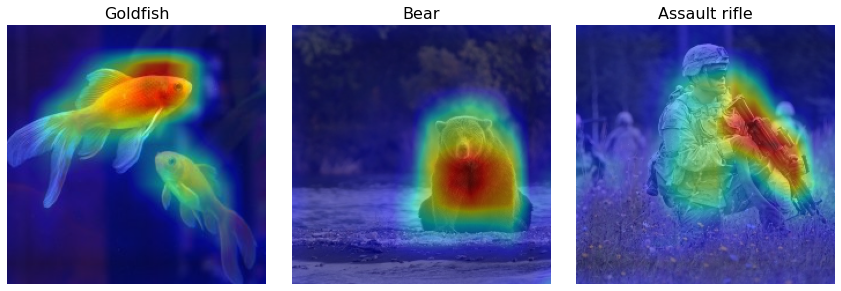

In [ ]:
# Create GradCAM++ object
model = keras.applications.vgg16.VGG16(weights='imagenet', include_top=True)
gradcam = GradcamPlusPlus(model,
              model_modifier=replace2linear,
              clone=True)

# Generate heatmap with GradCAM++
cam = gradcam(score,
        X,
        penultimate_layer=-1)

## Since v0.6.0, calling `normalize()` is NOT necessary.
# cam = normalize(cam)

# Render
f, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
for i, title in enumerate(image_titles):
    heatmap = np.uint8(cm.jet(cam[i])[..., :3] * 255)
    ax[i].set_title(title, fontsize=16)
    ax[i].imshow(images[i])
    ax[i].imshow(heatmap, cmap='jet', alpha=0.5)
    ax[i].axis('off')
plt.tight_layout()
plt.show()

As you can see above, Now, the visualized attentions almost completely cover the target objects!

Please refer to https://github.com/keisen/tf-keras-vis for more details

## Protodash using AXI360

You can find more examples here https://github.com/Trusted-AI/AIX360/tree/master/examples/protodash

## Counterfactual instances

You can find more informations here https://docs.seldon.io/projects/alibi/en/stable/methods/CFProto.html and https://github.com/interpretml/DiCE